In [ ]:
'''
모델
 - OLS (Ordinary Least Squares)
 - LinearRegression
 - DecisionTreeRegressor
 - SVR (Support Vector Regression)
 - RandomForestGenerator
 - keras

모델 결정을 위한 함수
 - mean_squared_error : 평균제곱근오차 함수
 - RandomizedSearchCV : 파라미터 최적화 함수
'''

# 데이터 불러오기

In [1]:
import pandas as pd

df = pd.read_csv("c:/nba_salary/csv/preprocess.csv")
df.head()

,inflationAdjSalary,Season,Age,G,GS,MP,FG,FGA,FG%,3P,...,STL,BLK,TOV,PF,PTS,pos_C,pos_PF,pos_PG,pos_SF,pos_SG
0,996827.0,1990,0.142857,0.500000,0.592593,0.256801,-0.170905,-0.220114,0.614286,-0.266667,...,-0.042553,0.384615,0.034091,1.196429,-0.174579,1,0,0,0,0
1,1881882.0,1990,0.142857,0.473684,1.037037,0.949229,0.887080,1.115750,-0.557143,2.316667,...,1.765957,-0.461538,0.840909,0.169643,1.140888,0,0,1,0,0
2,2543393.0,1990,0.571429,0.447368,0.407407,0.474441,1.049847,0.943074,0.671429,0.200000,...,-0.085106,0.153846,0.613636,0.776786,0.954058,0,0,0,1,0
3,1653775.0,1990,0.571429,0.368421,0.925926,0.974874,1.326551,1.428843,-0.042857,1.483333,...,1.595745,0.115385,1.340909,1.107143,1.326187,0,0,1,0,0
4,1140535.0,1990,0.000000,0.552632,-0.148148,0.396812,0.777213,0.728653,0.457143,-0.150000,...,0.468085,0.923077,0.386364,0.937500,0.588055,0,1,0,0,0


# 분석

In [27]:
dfX = df.iloc[:, 2:]
dfy = df.iloc[:, 0]

In [3]:
dfX

,Age,G,GS,MP,FG,FGA,FG%,3P,3PA,3P%,...,STL,BLK,TOV,PF,PTS,pos_C,pos_PF,pos_PG,pos_SF,pos_SG
0,0.142857,0.500000,0.592593,0.256801,-0.170905,-0.220114,0.614286,-0.266667,-0.339286,2.566265,...,-0.042553,0.384615,0.034091,1.196429,-0.174579,1,0,0,0,0
1,0.142857,0.473684,1.037037,0.949229,0.887080,1.115750,-0.557143,2.316667,2.208333,0.253012,...,1.765957,-0.461538,0.840909,0.169643,1.140888,0,0,1,0,0
2,0.571429,0.447368,0.407407,0.474441,1.049847,0.943074,0.671429,0.200000,0.190476,0.054217,...,-0.085106,0.153846,0.613636,0.776786,0.954058,0,0,0,1,0
3,0.571429,0.368421,0.925926,0.974874,1.326551,1.428843,-0.042857,1.483333,1.357143,0.301205,...,1.595745,0.115385,1.340909,1.107143,1.326187,0,0,1,0,0
4,0.000000,0.552632,-0.148148,0.396812,0.777213,0.728653,0.457143,-0.150000,-0.071429,-0.722892,...,0.468085,0.923077,0.386364,0.937500,0.588055,0,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11921,-0.571429,0.052632,0.833333,0.557616,1.249237,1.349146,-0.042857,1.950000,2.000000,0.114458,...,0.319149,-0.115385,2.204545,-0.026786,1.712098,0,0,1,0,0
11922,0.285714,-0.342105,0.055556,-0.218680,0.004069,-0.146110,1.685714,-0.250000,-0.196429,-1.090361,...,-0.234043,0.076923,-0.181818,0.062500,-0.038285,1,0,0,0,0
11923,0.285714,-0.342105,0.055556,-0.218680,0.004069,-0.146110,1.685714,-0.250000,-0.196429,-1.090361,...,-0.234043,0.076923,-0.181818,0.062500,-0.038285,1,0,0,0,0
11924,-0.428571,0.289474,0.277778,0.199965,0.313327,-0.013283,3.014286,-0.300000,-0.339286,-0.445783,...,-0.297872,1.807692,0.159091,0.651786,0.266462,1,0,0,0,0


In [4]:
dfX.columns

Index(['Age', 'G', 'GS', 'MP', 'FG', 'FGA', 'FG%', '3P', '3PA', '3P%', '2P',
       '2PA', '2P%', 'eFG%', 'FT', 'FTA', 'FT%', 'ORB', 'DRB', 'TRB', 'AST',
       'STL', 'BLK', 'TOV', 'PF', 'PTS', 'pos_C', 'pos_PF', 'pos_PG', 'pos_SF',
       'pos_SG'],
      dtype='object')

In [5]:
from sklearn.model_selection import train_test_split
import statsmodels.api as sm

dfX_train, dfX_test, dfy_train, dfy_test = train_test_split(dfX, dfy, test_size=0.2, random_state=10)

model = sm.OLS(dfy_train, dfX_train)
result = model.fit()
result.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:     inflationAdjSalary   R-squared:                       0.454
Model:                            OLS   Adj. R-squared:                  0.453
Method:                 Least Squares   F-statistic:                     304.6
Date:                Mon, 20 Mar 2023   Prob (F-statistic):               0.00
Time:                        15:53:23   Log-Likelihood:            -1.6172e+05
No. Observations:                9540   AIC:                         3.235e+05
Df Residuals:                    9513   BIC:                         3.237e+05
Df Model:                          26                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Age         2.158e+06   1.04e+05     20.815      0.000    1.95e+06    2.36e+06
G          -2.763e+06   2.32e+05    -11.927      0.000   -3.22e+06   -2.31e+06
GS          2.321e+06   2.43e+05      9.551      0.000    1.84e+06     2.8e+06
MP         -6.639e+06   5.46e+05    -12.168      0.000   -7.71e+06   -5.57e+06
FG          7.982e+05   3.07e+05      2.599      0.009    1.96e+05     1.4e+06
FGA         9210.6682   4.07e+05      0.023      0.982   -7.89e+05    8.07e+05
FG%          2.16e+06   2.24e+05      9.660      0.000    1.72e+06     2.6e+06
3P          3.449e+05   5.92e+05      0.583      0.560   -8.15e+05     1.5e+06
3PA         4.319e+06   6.41e+05      6.738      0.000    3.06e+06    5.58e+06
3P%         6.672e+04   7.91e+04      0.843      0.399   -8.84e+04    2.22e+05
2P          2.307e+06   4.22e+05      5.472      0.000    1.48e+06    3.13e+06
2PA        -1.262e+05   5.21e+05     -0.242      0.808   -1.15e+06    8.94e+05
2P%        -1.314e+05   1.21e+05     -1.085      0.278   -3.69e+05    1.06e+05
eFG%       -1.683e+06   2.03e+05     -8.299      0.000   -2.08e+06   -1.29e+06
FT         -1.479e+06   5.51e+05     -2.685      0.007   -2.56e+06   -3.99e+05
FTA          2.93e+06   6.08e+05      4.817      0.000    1.74e+06    4.12e+06
FT%         2.898e+05   8.48e+04      3.419      0.001    1.24e+05    4.56e+05
ORB        -1.493e+06   1.66e+05     -8.999      0.000   -1.82e+06   -1.17e+06
DRB         3.382e+06   1.44e+05     23.463      0.000     3.1e+06    3.66e+06
TRB         1.734e+06   8.21e+04     21.104      0.000    1.57e+06    1.89e+06
AST         1.682e+06    1.6e+05     10.496      0.000    1.37e+06       2e+06
STL        -7.769e+05   1.56e+05     -4.983      0.000   -1.08e+06   -4.71e+05
BLK         4.049e+05      7e+04      5.782      0.000    2.68e+05    5.42e+05
TOV        -8.767e+05   2.88e+05     -3.041      0.002   -1.44e+06   -3.12e+05
PF         -9.978e+05   2.39e+05     -4.181      0.000   -1.47e+06    -5.3e+05
PTS        -1.361e+05   2.45e+05     -0.556      0.578   -6.16e+05    3.44e+05
pos_C       3.083e+06   2.38e+05     12.961      0.000    2.62e+06    3.55e+06
pos_PF      3.059e+06   1.76e+05     17.421      0.000    2.72e+06     3.4e+06
pos_PG      2.154e+06   1.81e+05     11.886      0.000     1.8e+06    2.51e+06
pos_SF      2.572e+06   1.51e+05     17.083      0.000    2.28e+06    2.87e+06
pos_SG      2.464e+06   1.48e+05     16.640      0.000    2.17e+06    2.75e+06
==============================================================================
Omnibus:                     2613.866   Durbin-Watson:                   1.966
Prob(Omnibus):                  0.000   Jarque-Bera (JB):            10956.374
Skew:                           1.293   Prob(JB):                         0.00
Kurtosis:                       7.569   Cond. No.                     1.30e+16
==

In [ ]:
# 다중공선성 의심

# 다중공선성 해결

In [6]:
import seaborn as sns
import matplotlib.pyplot as plt

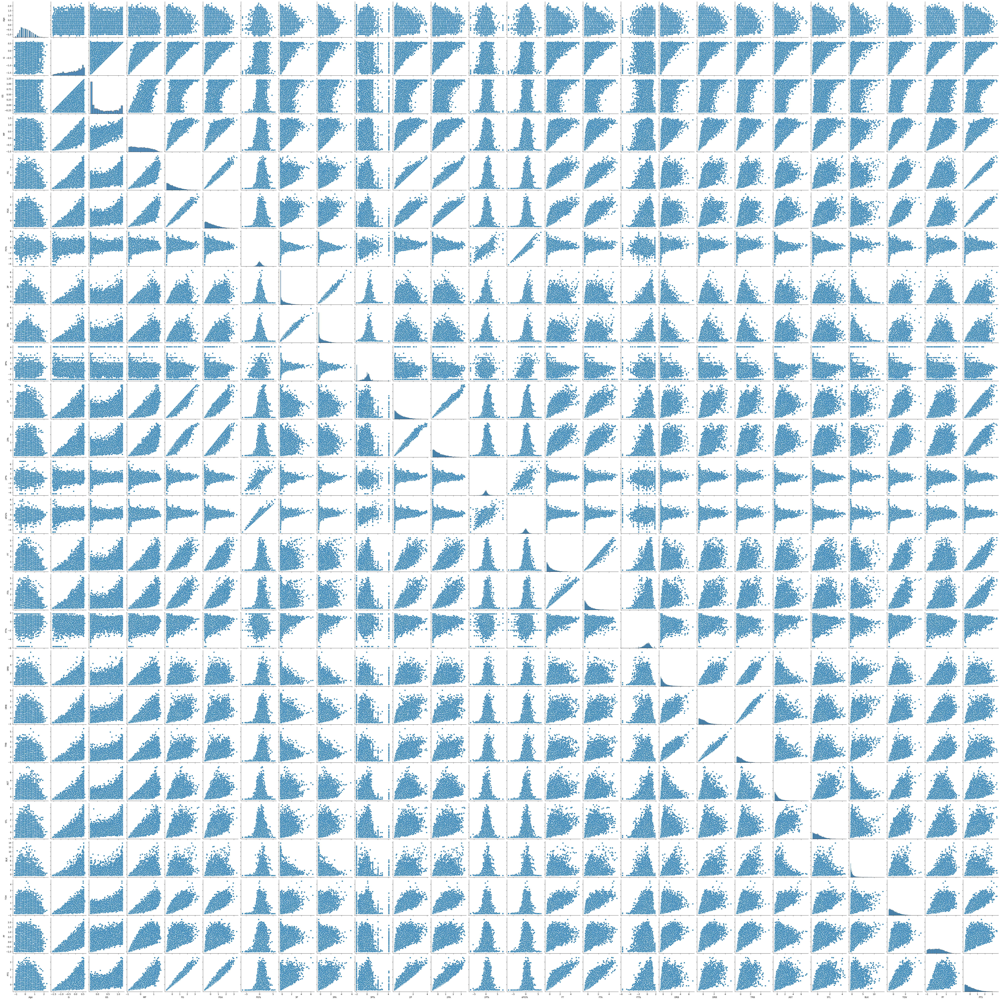

In [7]:
sns.pairplot(dfX.iloc[:, :-5])
plt.show()

In [8]:
dfX.corr()

,Age,G,GS,MP,FG,FGA,FG%,3P,3PA,3P%,...,STL,BLK,TOV,PF,PTS,pos_C,pos_PF,pos_PG,pos_SF,pos_SG
Age,1.000000,0.042109,0.059014,0.067810,0.020243,0.021059,0.007357,0.068732,0.056271,0.048902,...,0.038497,-0.025513,0.000019,0.030747,0.022316,0.046974,0.003157,0.014745,-0.019306,-0.038409
G,0.042109,1.000000,0.594711,0.836196,0.692614,0.698443,0.291069,0.388099,0.403457,0.027923,...,0.669918,0.418232,0.674578,0.828233,0.681565,0.049610,0.025477,-0.034496,0.007455,-0.038784
GS,0.059014,0.594711,1.000000,0.863252,0.811681,0.807620,0.270207,0.413150,0.428430,0.049725,...,0.719388,0.457106,0.777047,0.705044,0.803828,0.046213,-0.005606,-0.014669,0.017753,-0.035534
MP,0.067810,0.836196,0.863252,1.000000,0.915520,0.921606,0.293634,0.510555,0.530925,0.084773,...,0.829286,0.476019,0.875340,0.847348,0.911241,-0.014046,0.004507,-0.012336,0.029857,-0.008830
FG,0.020243,0.692614,0.811681,0.915520,1.000000,0.988563,0.332293,0.489423,0.508415,0.087332,...,0.757375,0.470413,0.886276,0.741110,0.991993,-0.006979,0.021004,-0.041556,0.019029,0.008658
FGA,0.021059,0.698443,0.807620,0.921606,0.988563,1.000000,0.238470,0.553895,0.579723,0.121404,...,0.774977,0.416017,0.892380,0.727759,0.987810,-0.057264,-0.004885,-0.011585,0.028455,0.036810
FG%,0.007357,0.291069,0.270207,0.293634,0.332293,0.238470,1.000000,-0.086380,-0.112400,-0.086994,...,0.182051,0.381806,0.244726,0.365767,0.299587,0.331842,0.137917,-0.194336,-0.048568,-0.170564
3P,0.068732,0.388099,0.413150,0.510555,0.489423,0.553895,-0.086380,1.000000,0.990240,0.444986,...,0.451428,-0.051333,0.410753,0.257977,0.545294,-0.258393,-0.144814,0.092116,0.067923,0.198660
3PA,0.056271,0.403457,0.428430,0.530925,0.508415,0.579723,-0.112400,0.990240,1.000000,0.424823,...,0.483248,-0.045452,0.443177,0.272661,0.564068,-0.270244,-0.148554,0.102027,0.071839,0.198599
3P%,0.048902,0.027923,0.049725,0.084773,0.087332,0.121404,-0.086994,0.444986,0.424823,1.000000,...,0.105955,-0.203663,0.049959,-0.076188,0.116117,-0.293565,-0.147044,0.120793,0.105539,0.165947


<AxesSubplot:>

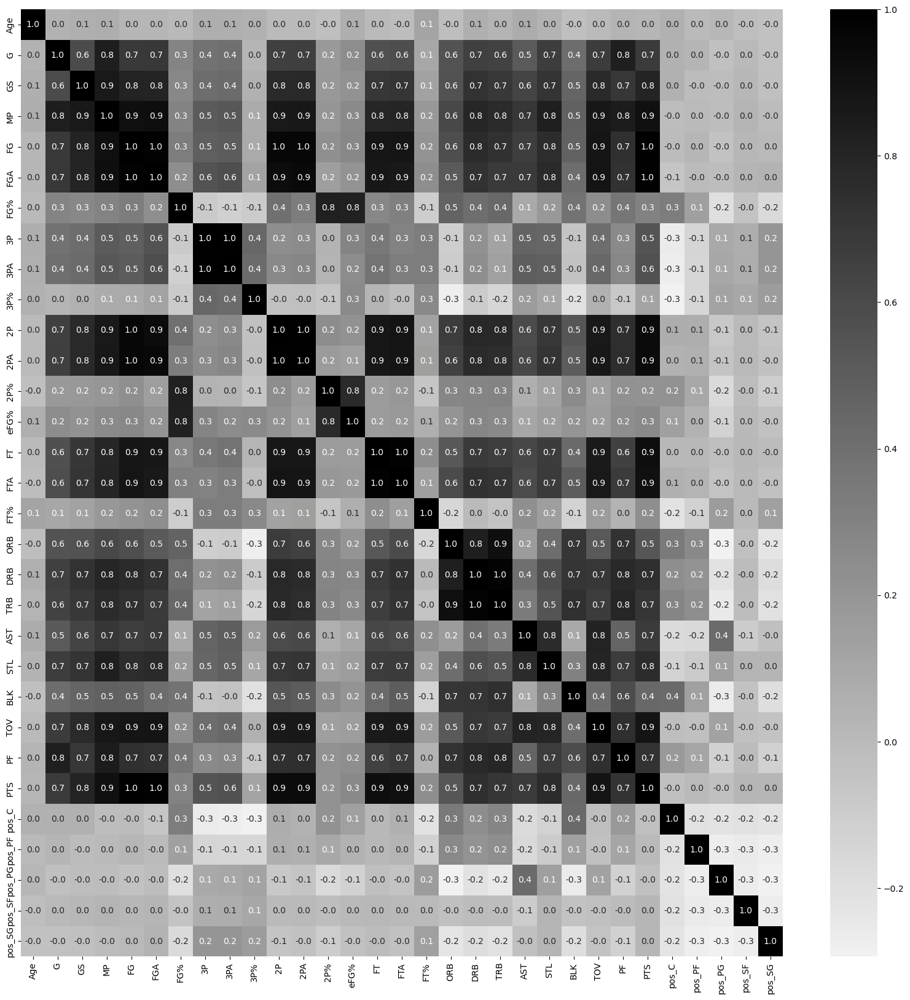

In [9]:
%matplotlib inline
plt.figure(figsize=(20,20))
cmap = sns.light_palette("black", as_cmap=True)
sns.heatmap(dfX.corr(), annot=True, fmt='3.1f', cmap=cmap)

In [10]:
# 상관계수 프린트
df_corr = dfX.corr()
columns = df_corr.columns

for i in range(len(columns)):
    for j in range(len(columns)):
        if df_corr.iloc[i, j] > 0.85:
            if columns[i] != columns[j]:
                print(columns[i], "&", columns[j], ":", df_corr.iloc[i, j])

GS & MP : 0.863252167059263
MP & GS : 0.863252167059263
MP & FG : 0.9155197767833928
MP & FGA : 0.9216055513830053
MP & 2P : 0.8630413739474477
MP & 2PA : 0.872340209925626
MP & TOV : 0.8753397799909818
MP & PTS : 0.9112412984334685
FG & MP : 0.9155197767833928
FG & FGA : 0.9885628241258748
FG & 2P : 0.9636008593867575
FG & 2PA : 0.9602187764304411
FG & FT : 0.883761697869881
FG & FTA : 0.8840436009288649
FG & TOV : 0.8862762704517014
FG & PTS : 0.991992637210757
FGA & MP : 0.9216055513830053
FGA & FG : 0.9885628241258748
FGA & 2P : 0.9310986863114875
FGA & 2PA : 0.9450857199540216
FGA & FT : 0.8738332564139416
FGA & FTA : 0.8660650731799162
FGA & TOV : 0.8923802751365454
FGA & PTS : 0.9878097778048037
3P & 3PA : 0.9902400804836574
3PA & 3P : 0.9902400804836574
2P & MP : 0.8630413739474477
2P & FG : 0.9636008593867575
2P & FGA : 0.9310986863114875
2P & 2PA : 0.9911394508561587
2P & FT : 0.8748488169480624
2P & FTA : 0.8917596035709605
2P & TOV : 0.8610710188461069
2P & PTS : 0.93755512

In [32]:
# 'FG', 'FGA', '3P', '3PA', '2P', '2PA','FT', 'FTA', 'TRB' 제거
dfX.drop(['FG', 'FGA', '3P', '3PA', '2P', '2PA','FT', 'FTA', 'TRB'], axis=1, inplace=True)

<AxesSubplot:>

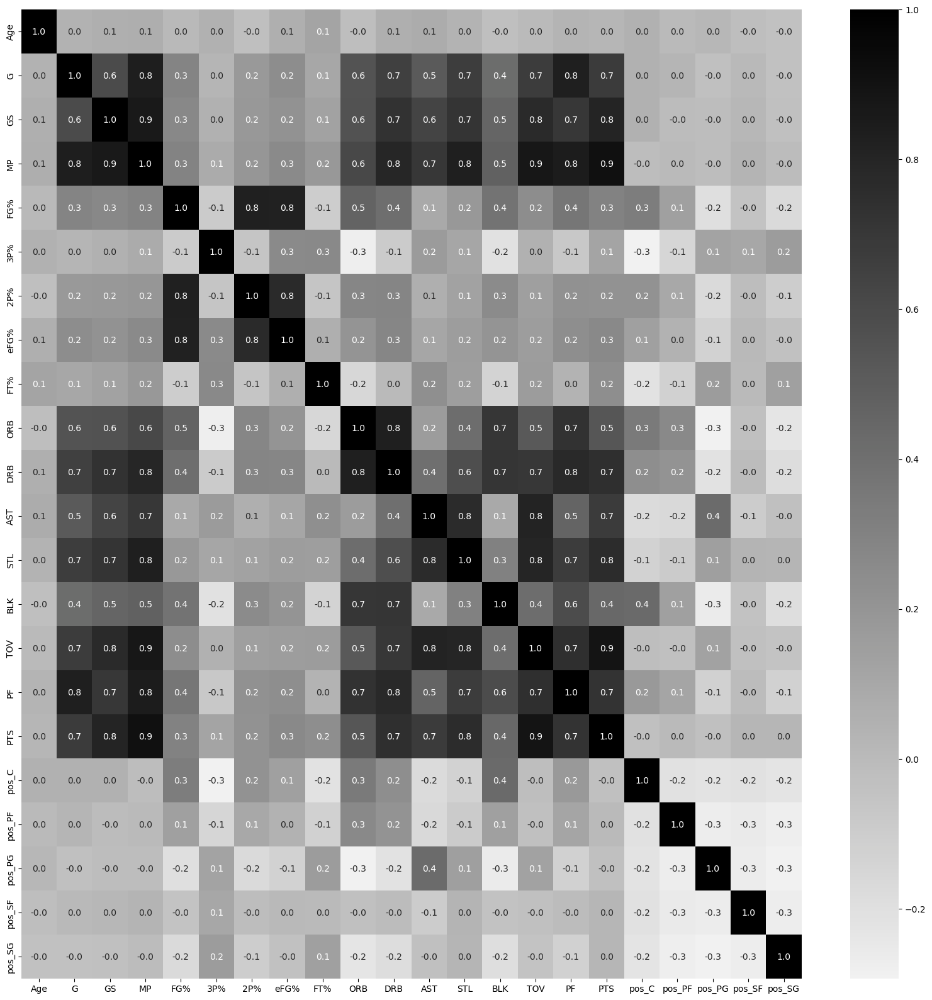

In [12]:
# 의존적인 변수들 제거 후 상관계수 다시 확인
%matplotlib inline
plt.figure(figsize=(20,20))
cmap = sns.light_palette("black", as_cmap=True)
sns.heatmap(dfX.corr(), annot=True, fmt='3.1f', cmap=cmap)

In [33]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

vif = pd.DataFrame()
vif["VIF Factor"] = [variance_inflation_factor(
    dfX.values, i) for i in range(dfX.shape[1])]
vif["features"] = dfX.columns
vif = vif.sort_values("VIF Factor").reset_index(drop=True)
vif

,VIF Factor,features
0,1.095714,Age
1,1.223583,pos_SF
2,1.299103,FT%
3,1.359402,pos_SG
4,1.687754,pos_PF
5,1.747437,3P%
6,2.122836,pos_PG
7,2.214575,pos_C
8,2.638214,BLK
9,3.692803,2P%


In [34]:
# 다중공선성 테스트
dfX_train, dfX_test, dfy_train, dfy_test = train_test_split(dfX, dfy, test_size=0.2, random_state=10)

model = sm.OLS(dfy_train, dfX_train)
result = model.fit()
result.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:     inflationAdjSalary   R-squared:                       0.430
Model:                            OLS   Adj. R-squared:                  0.429
Method:                 Least Squares   F-statistic:                     341.7
Date:                Mon, 20 Mar 2023   Prob (F-statistic):               0.00
Time:                        16:09:48   Log-Likelihood:            -1.6193e+05
No. Observations:                9540   AIC:                         3.239e+05
Df Residuals:                    9518   BIC:                         3.241e+05
Df Model:                          21                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Age         2.023e+06   1.06e+05     19.161      0.000    1.82e+06    2.23e+06
G          -2.439e+06   2.35e+05    -10.370      0.000    -2.9e+06   -1.98e+06
GS           2.21e+06   2.46e+05      8.973      0.000    1.73e+06    2.69e+06
MP         -5.319e+06   5.31e+05    -10.014      0.000   -6.36e+06   -4.28e+06
FG%        -8.199e+05   1.73e+05     -4.740      0.000   -1.16e+06   -4.81e+05
3P%        -5.563e+04   8.04e+04     -0.692      0.489   -2.13e+05    1.02e+05
2P%         2.963e+05   1.12e+05      2.642      0.008    7.65e+04    5.16e+05
eFG%        6.694e+05   1.58e+05      4.225      0.000    3.59e+05     9.8e+05
FT%        -1.461e+04   7.64e+04     -0.191      0.848   -1.64e+05    1.35e+05
ORB        -1.836e+06   1.55e+05    -11.843      0.000   -2.14e+06   -1.53e+06
DRB           4.8e+06   1.99e+05     24.141      0.000    4.41e+06    5.19e+06
AST         1.552e+06   1.61e+05      9.640      0.000    1.24e+06    1.87e+06
STL        -5.496e+05   1.58e+05     -3.474      0.001    -8.6e+05    -2.4e+05
BLK         2.588e+05   7.01e+04      3.693      0.000    1.21e+05    3.96e+05
TOV        -9.228e+05   2.75e+05     -3.352      0.001   -1.46e+06   -3.83e+05
PF         -1.085e+06   2.43e+05     -4.458      0.000   -1.56e+06   -6.08e+05
PTS         6.847e+06   2.65e+05     25.859      0.000    6.33e+06    7.37e+06
pos_C       5.086e+06   2.29e+05     22.250      0.000    4.64e+06    5.53e+06
pos_PF      4.652e+06   1.67e+05     27.862      0.000    4.33e+06    4.98e+06
pos_PG      3.525e+06    1.8e+05     19.581      0.000    3.17e+06    3.88e+06
pos_SF      3.983e+06   1.45e+05     27.419      0.000     3.7e+06    4.27e+06
pos_SG       3.86e+06   1.42e+05     27.200      0.000    3.58e+06    4.14e+06
==============================================================================
Omnibus:                     2635.762   Durbin-Watson:                   1.973
Prob(Omnibus):                  0.000   Jarque-Bera (JB):            11265.238
Skew:                           1.298   Prob(JB):                         0.00
Kurtosis:                       7.648   Cond. No.                         24.0
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [ ]:
# 조건변수 24로 좋아짐

# 후진제거법

# 모델

In [35]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(dfX, dfy, test_size=0.2, random_state=0)
print(X_train.shape, X_test.shape)

(9540, 22) (2386, 22)


In [38]:
from sklearn.metrics import mean_squared_error
import numpy as np

In [ ]:
'''
모델
 - OLS (Ordinary Least Squares)
 - LinearRegression
 - DecisionTreeRegressor
 - SVR (Support Vector Regression)
 - RandomForestGenerator
 - keras

모델 결정을 위한 함수
 - mean_squared_error : 평균제곱근오차 함수
 - RandomizedSearchCV : 파라미터 최적화 함수
'''

### OLS

In [36]:
model_OLS = sm.OLS(y_train, X_train)
result_OLS = model_OLS.fit()
result_OLS.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:     inflationAdjSalary   R-squared:                       0.429
Model:                            OLS   Adj. R-squared:                  0.428
Method:                 Least Squares   F-statistic:                     340.9
Date:                Mon, 20 Mar 2023   Prob (F-statistic):               0.00
Time:                        16:09:52   Log-Likelihood:            -1.6180e+05
No. Observations:                9540   AIC:                         3.237e+05
Df Residuals:                    9518   BIC:                         3.238e+05
Df Model:                          21                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Age         1.993e+06   1.04e+05     19.247      0.000    1.79e+06     2.2e+06
G          -2.517e+06   2.33e+05    -10.787      0.000   -2.97e+06   -2.06e+06
GS          2.072e+06   2.44e+05      8.490      0.000    1.59e+06    2.55e+06
MP         -4.727e+06   5.27e+05     -8.971      0.000   -5.76e+06   -3.69e+06
FG%        -7.142e+05   1.72e+05     -4.141      0.000   -1.05e+06   -3.76e+05
3P%        -2.916e+04   8.06e+04     -0.362      0.718   -1.87e+05    1.29e+05
2P%         2.633e+05   1.11e+05      2.378      0.017    4.63e+04     4.8e+05
eFG%        5.836e+05   1.58e+05      3.691      0.000    2.74e+05    8.94e+05
FT%         1.011e+04   7.58e+04      0.133      0.894   -1.38e+05    1.59e+05
ORB        -1.999e+06   1.53e+05    -13.067      0.000    -2.3e+06    -1.7e+06
DRB         4.928e+06   1.97e+05     24.955      0.000    4.54e+06    5.32e+06
AST         1.555e+06   1.59e+05      9.765      0.000    1.24e+06    1.87e+06
STL        -7.214e+05   1.57e+05     -4.605      0.000   -1.03e+06   -4.14e+05
BLK         2.423e+05   6.88e+04      3.523      0.000    1.07e+05    3.77e+05
TOV        -9.707e+05   2.72e+05     -3.569      0.000    -1.5e+06   -4.38e+05
PF         -1.129e+06   2.39e+05     -4.725      0.000    -1.6e+06   -6.61e+05
PTS          6.76e+06   2.64e+05     25.601      0.000    6.24e+06    7.28e+06
pos_C       5.056e+06   2.28e+05     22.220      0.000    4.61e+06     5.5e+06
pos_PF      4.775e+06   1.65e+05     28.875      0.000    4.45e+06     5.1e+06
pos_PG      3.546e+06   1.79e+05     19.796      0.000    3.19e+06     3.9e+06
pos_SF      4.163e+06   1.41e+05     29.519      0.000    3.89e+06    4.44e+06
pos_SG      3.918e+06    1.4e+05     27.994      0.000    3.64e+06    4.19e+06
==============================================================================
Omnibus:                     2595.258   Durbin-Watson:                   2.004
Prob(Omnibus):                  0.000   Jarque-Bera (JB):            10290.639
Skew:                           1.302   Prob(JB):                         0.00
Kurtosis:                       7.371   Cond. No.                         23.9
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

### LinearRegression

In [55]:
from sklearn.linear_model import LinearRegression

model_lin_reg = LinearRegression()
result_lin_reg = model_lin_reg.fit(X_train, y_train)

y_pred = model_lin_reg.predict(X_test)
rms = np.sqrt(mean_squared_error(y_test, y_pred))

print("학습용 설명력 :", result_lin_reg.score(X_train, y_train))
print("검증용 설명력 :", result_lin_reg.score(X_test, y_test))
print("오차 :", rms)

학습용 설명력 : 0.4292703895363228
검증용 설명력 : 0.429606514115514
오차 : 5832343.620503595


### DecisionTreeRegressor

In [68]:
from sklearn.tree import DecisionTreeClassifier

model_tree_reg = DecisionTreeClassifier(max_depth=10)
result_tree_reg = model_tree_reg.fit(X_train, y_train)

y_pred = model_tree_reg.predict(X_test)
rms = np.sqrt(mean_squared_error(y_test, y_pred))

print("학습용 설명력 :", result_tree_reg.score(X_train, y_train))
print("검증용 설명력 :", result_tree_reg.score(X_test, y_test))
print("오차 :", rms)

학습용 설명력 : 0.035744234800838576
검증용 설명력 : 0.012573344509639563
오차 : 9498450.414990168


### SVR

In [57]:
from sklearn.svm import SVR
model_svm_reg = SVR(kernel="linear")
result_svm_reg = model_svm_reg.fit(X_train, y_train)

y_pred = model_svm_reg.predict(X_test)
rms = np.sqrt(mean_squared_error(y_test, y_pred))

print("학습용 설명력 :", result_svm_reg.score(X_train, y_train))
print("검증용 설명력 :", result_svm_reg.score(X_test, y_test))
print("오차 :", rms)

학습용 설명력 : -0.13567353375546554
검증용 설명력 : -0.13272934995744223
오차 : 8218998.503662931


### RandomForestGenerator

In [58]:
from sklearn.ensemble import RandomForestRegressor
model_forest_reg = RandomForestRegressor(n_jobs=-1)
result_forest_reg = model_forest_reg.fit(X_train, y_train)

y_pred = model_forest_reg.predict(X_test)
rms = np.sqrt(mean_squared_error(y_test, y_pred))

print("학습용 설명력 :", result_forest_reg.score(X_train, y_train))
print("검증용 설명력 :", result_forest_reg.score(X_test, y_test))
print("오차 :", rms)

학습용 설명력 : 0.940848098863372
검증용 설명력 : 0.6057367058395096
오차 : 4848964.423017976


### keras

In [76]:
from keras.models import Sequential
from keras.layers import Dense
model_keras = Sequential() # 신경망 모형
model_keras.add(Dense(48, input_shape=(X_train.shape[1],), activation='relu', name='input'))
model_keras.add(Dense(24, activation='relu', name='hidden-1'))
model_keras.add(Dense(12, activation='relu', name='hidden-2'))
model_keras.add(Dense(6, activation='relu', name='hidden-3'))
model_keras.add(Dense(1, name='output'))
model_keras.compile(loss='mse', optimizer='adam', metrics=['mse', 'mae'])
model_keras.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input (Dense)               (None, 48)                1104      
                                                                 
 hidden-1 (Dense)            (None, 24)                1176      
                                                                 
 hidden-2 (Dense)            (None, 12)                300       
                                                                 
 hidden-3 (Dense)            (None, 6)                 78        
                                                                 
 output (Dense)              (None, 1)                 7         
                                                                 
Total params: 2,665
Trainable params: 2,665
Non-trainable params: 0
_________________________________________________________________


In [77]:
from keras.callbacks import EarlyStopping
early_stopping = EarlyStopping(monitor='val_loss', patience=50)
hist = model_keras.fit(X_train, y_train, epochs=1000, validation_split=0.2, callbacks=[early_stopping])

Epoch 1/1000
239/239 [==============================] - 1s 2ms/step - loss: 99356820635648.0000 - mse: 99356820635648.0000 - mae: 6655383.5000 - val_loss: 101956290871296.0000 - val_mse: 101956290871296.0000 - val_mae: 6761363.5000
Epoch 2/1000
239/239 [==============================] - 0s 1ms/step - loss: 98104325963776.0000 - mse: 98104325963776.0000 - mae: 6588345.0000 - val_loss: 97991448854528.0000 - val_mse: 97991448854528.0000 - val_mae: 6552580.0000
Epoch 3/1000
239/239 [==============================] - 0s 1ms/step - loss: 86501387927552.0000 - mse: 86501387927552.0000 - mae: 5962710.0000 - val_loss: 76600095801344.0000 - val_mse: 76600095801344.0000 - val_mae: 5410736.5000
Epoch 4/1000
239/239 [==============================] - 0s 1ms/step - loss: 60933212733440.0000 - mse: 60933212733440.0000 - mae: 4760808.0000 - val_loss: 54302395596800.0000 - val_mse: 54302395596800.0000 - val_mae: 4607603.5000
Epoch 5/1000
239/239 [==============================] - 0s 1ms/step - loss: 49

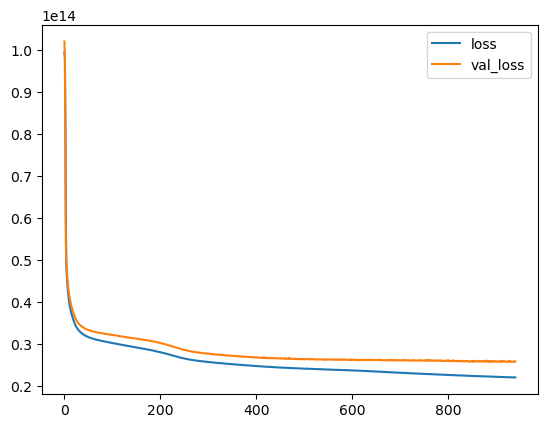

In [78]:
# 결과 시각화
plt.plot(hist.history['loss'])
plt.plot(hist.history['val_loss'])
plt.legend(['loss','val_loss'])
plt.show()

In [79]:
# 평가
scores = model_keras.evaluate(X_train, y_train)
print(scores)

scores = model_keras.evaluate(X_test, y_test)
print(scores)

299/299 [==============================] - 0s 904us/step - loss: 22834241863680.0000 - mse: 22834241863680.0000 - mae: 3273555.2500
[22834241863680.0, 22834241863680.0, 3273555.25]
75/75 [==============================] - 0s 973us/step - loss: 24631679385600.0000 - mse: 24631679385600.0000 - mae: 3351216.7500
[24631679385600.0, 24631679385600.0, 3351216.75]


In [80]:
from sklearn.metrics import r2_score

pred = model_keras.predict(X_test)
r2_score(y_test, pred)

75/75 [==============================] - 0s 774us/step


0.5869692923421663